In [1]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

# #NEWS on Twitter

---
Background:

The data used in this project was sourced using the `snscrape` package to scrape Twitter. The subject of the search was #news. The search parameters extended from January 2021 until August 2022. The search yielded 15gb of data which equate to a little over 6 million tweets. In this notebook, we analyze the resulting networks that arise from within this content.

---


In [90]:
# Import libraries
import pandas as pd
import re
import string
from collections import Counter
import networkx as nx
import nltk
from nltk.corpus import words
import gensim
import gensim.corpora as corpora
from gensim.models import CoherenceModel
from gensim.models.ldamulticore import LdaMulticore
import matplotlib.pyplot as plt
import openai
import json
import ast
from igraph import *
from textblob import TextBlob
import numpy as np
import os
os.chdir('/home/dataguy/Documents/')
os.environ['PYSPARK_SUBMIT_ARGS'] = '--jars graphframes-0.8.2-spark3.0-s_2.12.jar pyspark-shell'
from neo4j import GraphDatabase, basic_auth
from graph_tool.all import *
import graphistry
from IPython.core.display import display
from IPython.display import IFrame
import pyspark 
from pyspark import SparkContext, SparkConf
from pyspark.sql import SQLContext, SparkSession
from pyspark.sql.types import StructType, StructField, DoubleType, IntegerType, StringType, ArrayType, FloatType
from pyspark.sql.functions import udf, col, size, lit, explode, isnan, when, count, min, max, struct, array, monotonically_increasing_id
from pyspark.ml.feature import HashingTF, IDF, Tokenizer, IndexToString, StringIndexer, VectorIndexer, CountVectorizer
import nxviz as nv
%matplotlib inline
import holoviews as hv
from holoviews import opts
from holoviews.operation.datashader import datashade, bundle_graph
import datashader as ds
import datashader.transfer_functions as tf
from datashader.layout import random_layout, circular_layout, forceatlas2_layout
from datashader.bundling import connect_edges, hammer_bundle
import warnings
warnings.filterwarnings('ignore')
#from community import community_louvain
import community
from zxs import *

In [6]:
os.chdir('/home/dataguy/Downloads')

In [7]:
!ls

firefox.tmp				graphframes-0.8.2-spark3.0-s_2.12.jar
gephi-0.9.7				headshot.png
gephi-0.9.7-linux-x64.tar.gz		jdk-11.0.16+8
google-chrome-stable_current_amd64.deb	neo4j-desktop-1.4.15-x86_64.AppImage
graphframes-0.8.2-spark2.4-s_2.11.jar	Profile.pdf


In [8]:
#!pyspark --packages graphframes:graphframes:0.8.2-spark3.0-s_2.12 --jars graphframes-0.8.2-spark3.0-s_2.12.jar
#os.environ['PYSPARK_SUBMIT_ARGS'] = '--packages graphframes:graphframes:0.8.1-spark3.0-s_2.12 pyspark-shell'
#from graphframes import *

#import snap
# SNAP
# create a graph TNGraph
#g1 = snap.TNGraph.New()

#for tweeter in nodes:
    
#    g1.AddNode(tweeter)

# Initialize spark
#conf = pyspark.SparkConf().set('spark.driver.host','127.0.0.1').setMaster("local[*]")
#sc = SparkContext.getOrCreate(SparkConf().setMaster("local[*]"))
#spark = SparkSession.builder.config("spark.jars.packages", "graphframes:graphframes:0.8.1-spark3.0-s_2.12").config("spark.jars.repositories", "https://repos.spark-packages.org").getOrCreate()

# Init
#conf = SparkConf().set('spark.driver.host', '192.168.1.159').set('spark.jars', '/home/dataguy/.ivy2/jars').setMaster('local[*]')
#sc = SparkContext.getOrCreate(conf)
#sc.addPyFile('graphframes-0.8.2-spark3.0-s_2.12.jar')
#spark = SparkSession.builder.getOrCreate()

In [9]:
# Initialize spark
sc = SparkContext.getOrCreate(SparkConf().setMaster("local[*]"))
spark = SparkSession.builder.getOrCreate()

22/08/28 18:00:24 WARN Utils: Your hostname, computer resolves to a loopback address: 127.0.1.1; using 192.168.1.159 instead (on interface wlp0s20f3)
22/08/28 18:00:24 WARN Utils: Set SPARK_LOCAL_IP if you need to bind to another address
22/08/28 18:00:24 WARN NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable
Using Spark's default log4j profile: org/apache/spark/log4j-defaults.properties
Setting default log level to "WARN".
To adjust logging level use sc.setLogLevel(newLevel). For SparkR, use setLogLevel(newLevel).


In [10]:
# Read
df = spark.read.json('/home/dataguy/hashtag-news.json')

22/08/28 18:00:40 WARN package: Truncated the string representation of a plan since it was too large. This behavior can be adjusted by setting 'spark.sql.debug.maxToStringFields'.


In [11]:
# Inspect
min_date, max_date = df.select(min("date"), max("date")).first()
print(f'Total # Tweets: {df.count()}')
print(f"Min Date- {min_date}")
print(f"Max Date- {max_date}")

Total # Tweets: 6080314
Min Date- 2021-01-11T06:14:01+00:00
Max Date- 2022-08-23T14:19:11+00:00


In [12]:
# Expand
df1 = df.withColumn('username', col('user.username')).withColumn('country', col('place.country')).withColumn('country_cd', col('place.countryCode'))
df2 = df1.withColumn('quoted', col('quotedTweet.user.username')).withColumn('mentions', col('mentionedUsers.username')).withColumn('reply_to', col('inReplyToUser.username')).drop('inReplyToUser', 'mentionedUsers', 'renderedContent', 'id', 'media', 'outlinks', '_type', 'cashtags', 'conversationId', 'inReplyToTweetId', 'source', 'sourceUrl', 'sourceLabel', 'tcooutlinks', 'url', 'country', 'lang', 'retweetedTweet', 'user', 'coordinates', 'place', 'quotedTweet').sample(.2)

# Extract nodes
users = [x[0] for x in df2.select('username').distinct().collect()]
quoted = [x[0] for x in df2.select('quoted').distinct().collect()]
mentions = df2.select('mentions').distinct().collect()
replies = [x[0] for x in df2.select('reply_to').distinct().collect()]

# Flatten
mnts = []

# Iterate mentions
for x in mentions:
    
    for y in x:
        
            if y:
                
                for z in y:
                
                    mnts.append(z)
                    
nodes = users + quoted + mnts + replies
nodes = [i for i in set(nodes)]

In [13]:
# Function to for edges
def get_quotes(x, y):

    if y is not None:
        
        edges.append((x, y, 'quote'))
    
    else:
        
        pass
    
def get_mentions(x, y):
    
    if y is not None:
        
        for z in y:
            
            edges.append((x, z, 'mention'))
            
    else:
        
        pass
    
def get_replies(x, y):
    
    if y is not None:
        
        edges.append((x, y, 'reply'))

In [14]:
# Apply functions to build edges
edges = []

# Quotes
for x, y in df2.select('username', 'quoted').collect(): get_quotes(x, y)
for x, y in df2.select('username', 'mentions').collect(): get_mentions(x, y)
for x, y in df2.select('username', 'reply_to').collect(): get_replies(x, y)

edgedf = pd.DataFrame(edges, columns = ['source', 'target', 'type'])
edgedf = edgedf.groupby(['source', 'target', 'type']).size().reset_index().rename({0: 'weight'}, axis = 1)
edgedf = edgedf[edgedf['source'] != edgedf['target']]

In [15]:
nodedf = pd.DataFrame(nodes, columns = ['username'])
nde = pd.DataFrame(nodes, columns = ['username'])
nde['id'] = [i for i in range(0, len(nde))]

In [16]:
nde.head()

,username,id
0,SocialMarbella,0
1,MassLWD,1
2,SurajResearch,2
3,TAG24_NEWS,3
4,GovAyoFayose,4


In [17]:
edg = edgedf.merge(nde, how = 'left', left_on = 'source', right_on = 'username').rename({'id': 'src'}, axis = 1).drop('username', axis = 1)
edg = edg.merge(nde, how = 'left', left_on = 'target', right_on = 'username').rename({'id': 'dst'}, axis = 1).drop('username', axis = 1)

In [18]:
edg.head()

,source,target,type,weight,src,dst
0,004nino,HDNER,mention,1,67260,10625
1,004nino,denverpost,mention,1,67260,110469
2,007HeadedDragon,TimeOutTravel,quote,1,48663,89429
3,00Emp2,KaneMayfield,quote,1,64208,69583
4,01_airdrop,Owlwala,mention,1,38171,66680


In [ ]:
'''
    GraphFrames
'''

# Build dataframes
sparknodes = spark.createDataFrame(nde, ['username', 'id'])
sparkedges = spark.createDataFrame(edg, ['source', 'target', 'type', 'weight', 'src', 'dst'])

In [ ]:
#graph = GraphFrame(sparknodes, sparkedges)
# Find most important tweeters
#results = graph.pageRank(resetProbability = 0.01, maxIter = 100)
#results.vertices.select("id", "pagerank").show()

In [19]:
'''
    Network X 
'''

sample = edgedf.sort_values('weight', ascending = False)[0:5000]

In [20]:
# Graph
g = nx.from_pandas_edgelist(sample, 
                            source = 'source',
                            target = 'target',
                            edge_attr = ['type', 'weight'],
                            create_using = nx.DiGraph())

<Figure size 1440x1080 with 0 Axes>

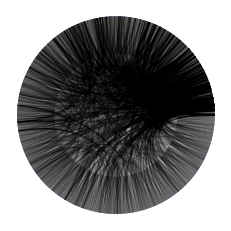

In [21]:
# Create the CircosPlot object: c
plt.figure(figsize = (20, 15))
c = nv.CircosPlot(g)
plt.show()

In [23]:
# Functions for plotting w/ datashader
def nodesplot(nodes, name = None, canvas = None, cat = None):
    
    canvas = ds.Canvas(**cvsopts) if canvas is None else canvas
    aggregator = None if cat is None else ds.count_cat(cat)
    agg = canvas.points(nodes,'x','y',aggregator)
    
    return tf.spread(tf.shade(agg, cmap = ["#FF3333"]), px = 3, name = name)

def edgesplot(edges, name = None, canvas = None):
    
    canvas = ds.Canvas(**cvsopts) if canvas is None else canvas
    return tf.shade(canvas.line(edges, 'x','y', agg = ds.count()), name = name)
    
def graphplot(nodes, edges, name = "", canvas = None, cat = None):
    
    if canvas is None:
        
        xr = nodes.x.min(), nodes.x.max()
        yr = nodes.y.min(), nodes.y.max()
        
        canvas = ds.Canvas(x_range = xr, y_range = yr, **cvsopts)
        
    np = nodesplot(nodes, name + " nodes", canvas, cat)
    ep = edgesplot(edges, name + " edges", canvas)
    
    return tf.stack(ep, np, how = "over", name = name)

In [24]:
nodes = pd.DataFrame(["node" + str(i) for i in range(1000)], columns = ['name'])
edges = pd.DataFrame(np.random.randint(0,len(nodes), size = (20000, 2)), columns = ['source', 'target'])

In [25]:
circularloc  = circular_layout(nodes, uniform = False)
randomloc = random_layout(nodes)
randomloc.tail()

,name,x,y
995,node995,0.457818,0.065210
996,node996,0.877808,0.037704
997,node997,0.298672,0.029140
998,node998,0.825358,0.197285
999,node999,0.105981,0.631196


In [26]:
edges.head()

,source,target
0,77,525
1,20,160
2,692,717
3,280,159
4,966,427


Random layout,Circular layout

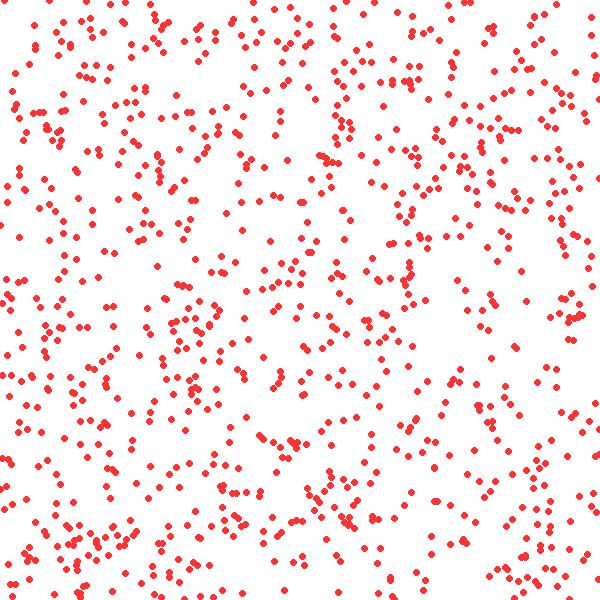
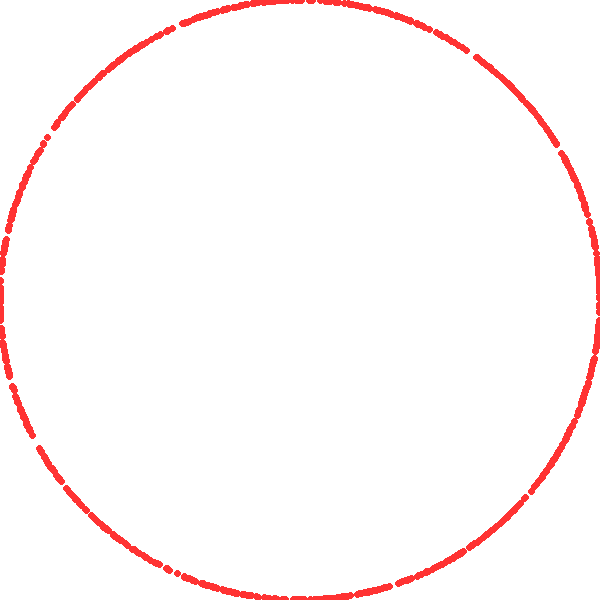

In [34]:
tf.Images(nodesplot(randomloc, "Random layout"), nodesplot(circularloc, "Circular layout"))

CPU times: user 931 ms, sys: 0 ns, total: 931 ms
Wall time: 928 ms


ForceAtlas2 layout

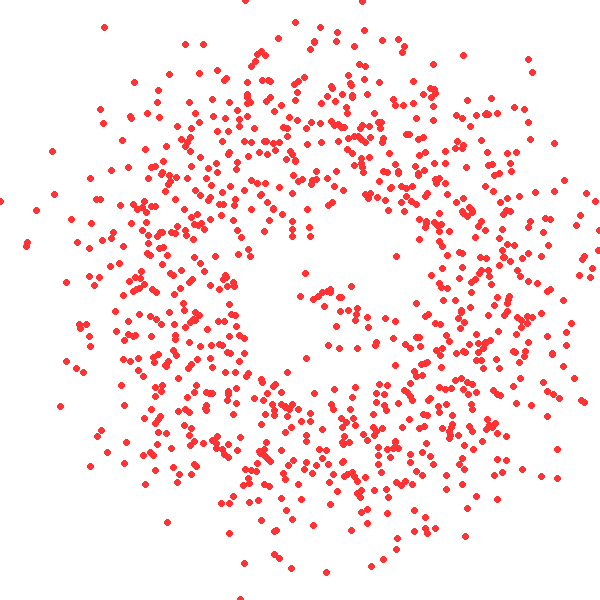

In [35]:
%time forcedirectedloc = forceatlas2_layout(nodes, edges)
tf.Images(nodesplot(forcedirectedloc, "ForceAtlas2 layout"))

In [36]:
cd = circularloc
fd = forcedirectedloc

%time a = graphplot(cd, connect_edges(cd,edges), "Circular layout")
%time b = graphplot(fd, connect_edges(fd,edges), "Force Directed layout")
%time c = graphplot(cd, hammer_bundle(cd, edges), "Circular layout, bundled")
%time d = graphplot(fd, hammer_bundle(fd, edges), "Force-directed, bundled")

CPU times: user 100 ms, sys: 0 ns, total: 100 ms
Wall time: 98.7 ms
CPU times: user 91.6 ms, sys: 0 ns, total: 91.6 ms
Wall time: 91.4 ms
CPU times: user 22.6 s, sys: 0 ns, total: 22.6 s
Wall time: 22.6 s
CPU times: user 14.7 s, sys: 0 ns, total: 14.7 s
Wall time: 14.7 s


Circular layout,Force Directed layout
"Circular layout, bundled","Force-directed, bundled"

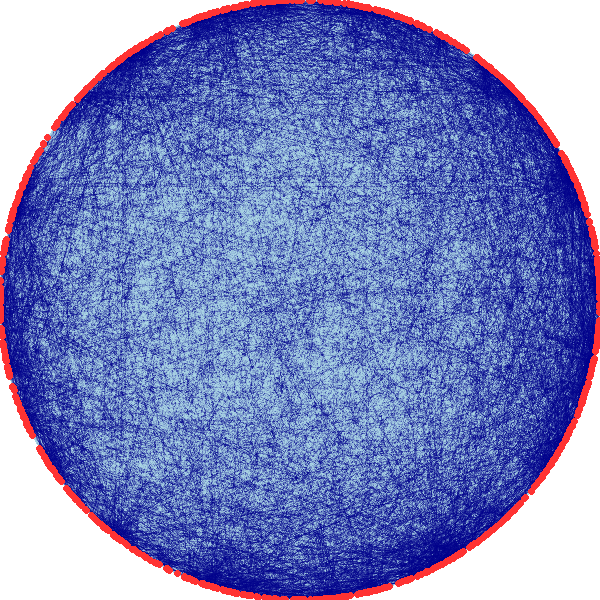
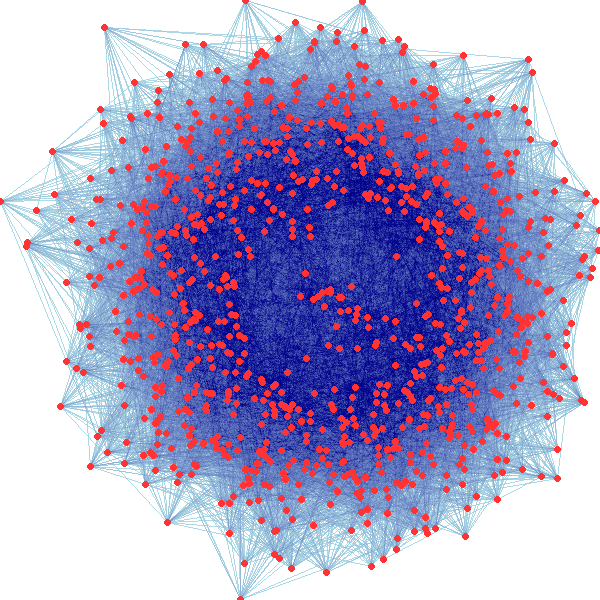
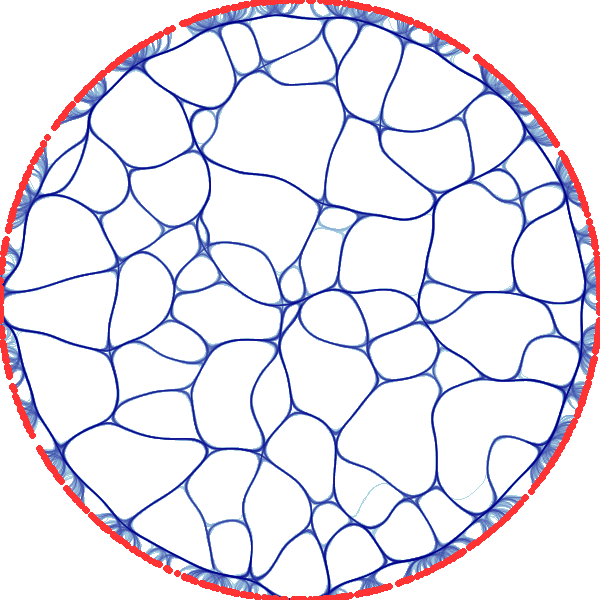
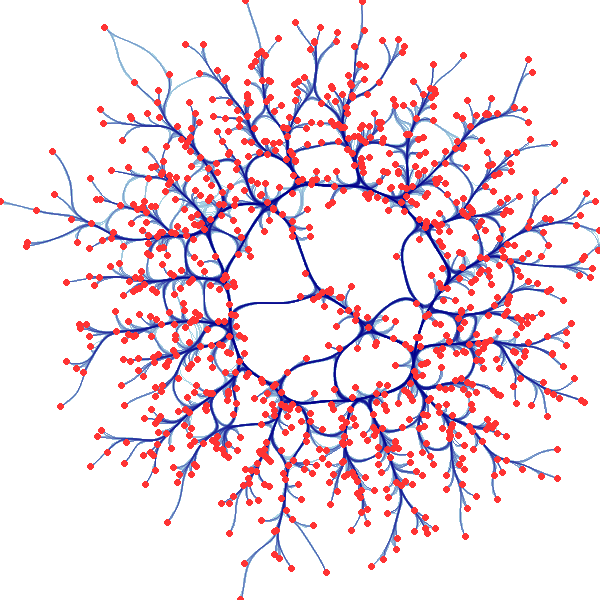

In [37]:
tf.Images(a, b, c, d).cols(2)

In [38]:
sample

,source,target,type,weight
112869,thehindupatrika,TheNileshDesai,mention,2932
44885,MetronixSA,TechCrunch,mention,1932
57469,Rodrick76496943,SportfusionApps,mention,1549
50982,Othershawnlong,xdadevelopers,mention,1168
35912,Jessica_L_Hunt,baltimoresun,mention,1048
...,...,...,...,...
29913,GutshotMagazine,PokerBaazi,mention,4
39663,LateAgainZen,patdixon,mention,4
42270,Mabbati24,GvtMonaco,mention,4
117143,wnctimes,CityofAsheville,mention,4


In [39]:
sample_nodes = pd.DataFrame(pd.unique(sample[['source', 'target']].values.ravel('K')), columns = ['username'])
sample_edges = pd.DataFrame()

for idx, row in sample.iterrows():
    
    x = sample_nodes[sample_nodes['username'] == row['source']].index[0]
    y = sample_nodes[sample_nodes['username'] == row['target']].index[0]
    
    sample_edges = sample_edges.append({'source': x,
                                        'target': y,
                                        'weight': row['weight']}, ignore_index = True)

In [40]:
sample_edges.head()

,source,target,weight
0,0,1469,2932
1,1,1470,1932
2,2,1471,1549
3,3,1472,1168
4,4,1473,1048


In [41]:
sample_nodes[sample_nodes['username'] == row['source']].index[0]

116

In [42]:
circularloc  = circular_layout(sample_nodes, uniform = False)
forcedirectedloc = forceatlas2_layout(sample_nodes, sample_edges)

In [43]:
cd = circularloc
fd = forcedirectedloc

%time a = graphplot(cd, connect_edges(cd, sample_edges), "Circular layout")
%time b = graphplot(fd, connect_edges(fd, sample_edges), "Force Directed layout")
%time c = graphplot(cd, hammer_bundle(cd, sample_edges), "Circular layout, bundled")
%time d = graphplot(fd, hammer_bundle(fd, sample_edges), "Force-directed, bundled")

CPU times: user 54.5 ms, sys: 0 ns, total: 54.5 ms
Wall time: 53.4 ms
CPU times: user 39.6 ms, sys: 0 ns, total: 39.6 ms
Wall time: 39.4 ms
CPU times: user 6.05 s, sys: 0 ns, total: 6.05 s
Wall time: 6.05 s
CPU times: user 1.69 s, sys: 0 ns, total: 1.69 s
Wall time: 1.69 s


Circular layout,Force Directed layout
"Circular layout, bundled","Force-directed, bundled"

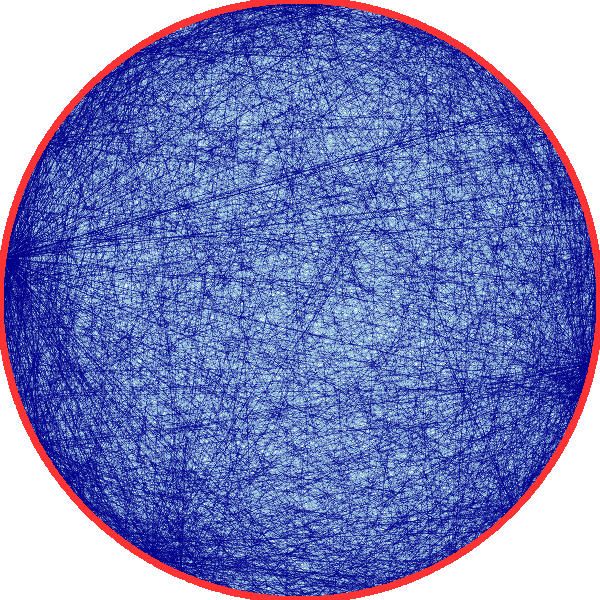
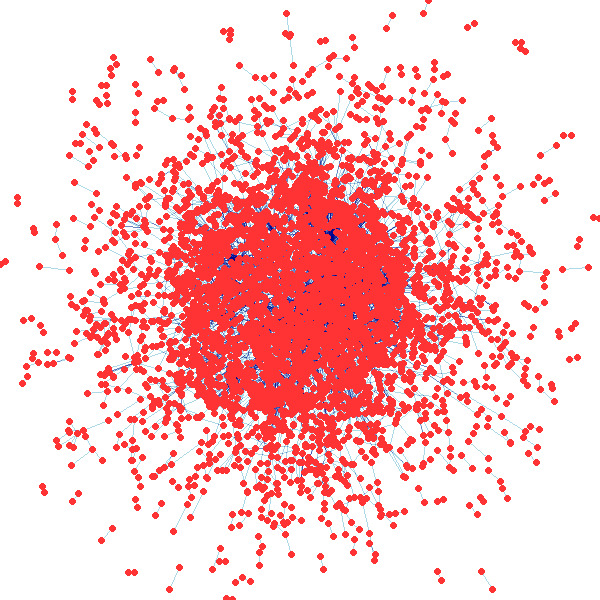
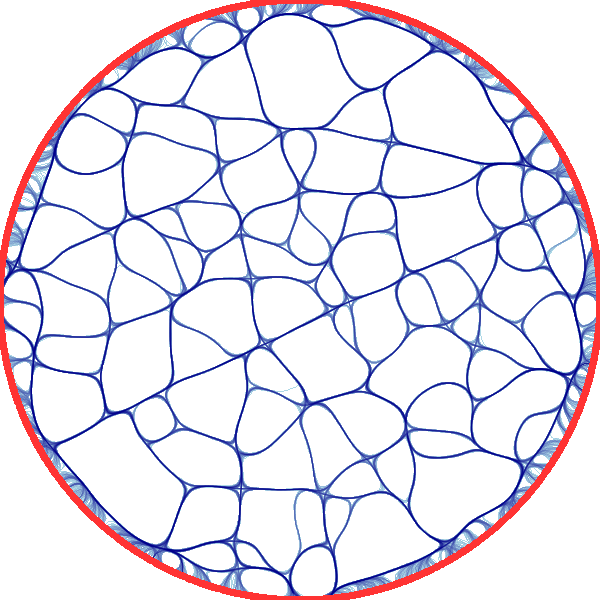
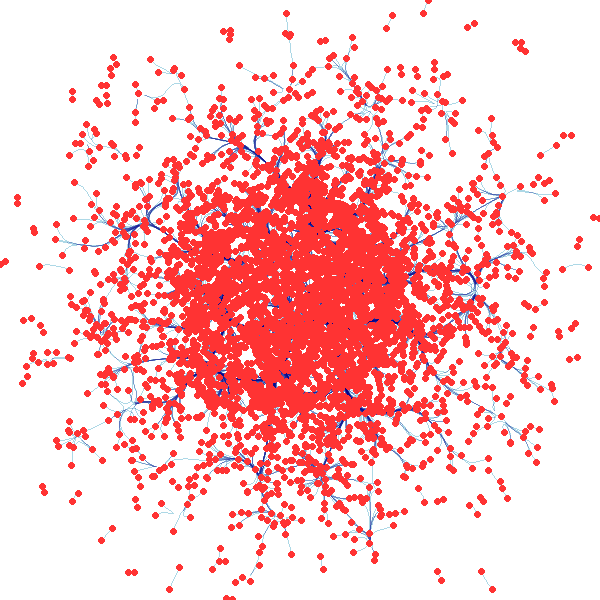

In [44]:
tf.Images(a, b, c, d).cols(2)

In [45]:
# Holoviews
kwargs = dict(width = 800, height = 800, xaxis = None, yaxis = None)
opts.defaults(opts.Nodes(**kwargs), opts.Graph(**kwargs))
colors = ['#000000'] + hv.Cycle('Category20').values

graph = hv.Graph(sample_edges)
bundled = bundle_graph(graph)
datashaded = (datashade(bundled, normalization = 'linear', width = 1000, height = 1000) * bundled.nodes).opts(opts.Nodes(color = 'circle', size = 10, width = 800, cmap = colors, legend_position = 'right'))

In [46]:
graph

:Graph   [source,target]   (weight)

In [47]:
bundled

:Graph   [source,target]   (weight)

In [48]:
datashaded

 Parameter(s) [normalization] not consumed by any element rasterizer.

 Parameter(s) [normalization] not consumed by any element rasterizer.



:DynamicMap   []
   :Overlay
      .RGB.I   :RGB   [x,y]   (R,G,B,A)
      .Nodes.I :Nodes   [x,y,index]

In [49]:
'''
    NetworkX
'''

g = nx.Graph(sample_edges)

In [50]:
print(nx.info(g))

Graph with 5093 nodes and 4783 edges


In [51]:
# Apply algorithm to find communities
comms = community_louvain.best_partition(g)

In [52]:
unique_coms = np.unique(list(comms.values()))

In [53]:
len(unique_coms)

808

In [54]:
len(comms)

5093

In [55]:
len(sample_edges)

5000

# Centrality measures

Degree: Measures number of incoming connections

Closeness: Measures how quickly (minimum number of steps) can one trader connect to others in the network

Eigenvector: Measures a trader’s connection to those who are highly connected. A person with a high score will be someone who is influencing multiple players (who in turn are highly connected) and is exercising control behind the scenes.

In [75]:
# Calculate centrality measures for graph
degree_centrality = nx.degree_centrality(g)
closeness_centrality = nx.closeness_centrality(g)
eigenvector_centrality = nx.eigenvector_centrality(g, tol = 1.0e-3)

In [82]:
# Top 10 values of degree centrality 
for k, v in dict(Counter(degree_centrality).most_common(10)).items():
    
    k = sample_nodes.iloc[k]['username']
    
    print(k)

ChimpReports
EppleMedia
YouTube
hennemusic
AbsoluteIndNews
TheWhiskyBiz
TheHTAfrica
MetronixSA
MTV
fpjindia


In [83]:
# Top 10 values of closeness centrality 
for k, v in dict(Counter(closeness_centrality).most_common(10)).items():
    
    k = sample_nodes.iloc[k]['username']
    
    print(k)

EppleMedia
POTUS
JoeBiden
AbsoluteIndNews
WHO
TheHTAfrica
OneidaShark
CNN
nytimes
washingtonpost


In [84]:
# Top 10 values of eigenvector centrality 
for k, v in dict(Counter(eigenvector_centrality).most_common(10)).items():
    
    k = sample_nodes.iloc[k]['username']
    
    print(k)

ChimpReports
EppleMedia
WHO
AbsoluteIndNews
YouTube
POTUS
UN
BorisJohnson
nytimes
CNN


In [96]:
# Community detection
partitions = community.best_partition(g, weight = 'weight')
vals = [partitions.get(node) for node in g.nodes()]